![](https://www.dii.uchile.cl/wp-content/uploads/2021/06/Magi%CC%81ster-en-Ciencia-de-Datos.png)

# Proyecto: Innovación Tecnológica en Bodoque Bank

**MDS7202: Laboratorio de Programación Científica para Ciencia de Datos**

### Cuerpo Docente:

- Profesor: Pablo Badilla, Ignacio Meza De La Jara
- Auxiliar: Sebastián Tinoco
- Ayudante: Diego Cortez M., Felipe Arias T.

----

## Reglas

- Fecha de entrega: 01/06/2021
- **Grupos de 2 personas.**
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Estrictamente prohibida la copia. 
- Pueden usar cualquier material del curso que estimen conveniente.

# Motivación

![](https://www.geekmi.news/__export/1621969098810/sites/debate/img/2021/05/25/juan-carlos-bodoque-1.jpg_554688468.jpg)

Juan Carlos Bodoque, el famoso periodista y empresario, decidió diversificar su portafolio de negocios y crear su propio banco. Después de varios años de investigar y analizar el mercado financiero, finalmente logró fundar su entidad bancaria con el objetivo de ofrecer a sus clientes una experiencia personalizada y confiable en sus transacciones financieras. 

Sin embargo, con las nuevas tecnologías, aparecen nuevos desafíos para la joven entidad bancaria. Por ello, Bodoque decide invertir en un equipo de expertos en tecnología y finanzas, para que Bodoque Bank implemente las últimas innovaciones en seguridad y servicio al cliente para garantizar la satisfacción y fidelización de sus clientes.

El primer objetivo de la entidad bancaria será la detección de potenciales clientes fraudulentos, para ello Bodoque Bank les hace entrega de un extenso dataset en el que se registran las actividades que han realizado sus clientes durante los últimos meses. Uno de los puntos que resaltan al pasar el conjunto de datos es que el nombre de los usuarios está protegido y que consideren cada una de las filas como una muestra independiente de la otra.

Tras la solicitud, uno de los mayores accionistas del banco llamado Mario Hugo, les sugiere que al momento de realizar el proyecto tomen las siguientes consideraciones:

- Realicen un análisis exhaustivo de cada variable, ya que los directores tienden a ser quisquillosos con puntos o definiciones sin algún fundamento claro.
- Deben ser muy claros de cómo encontrar los outliers y si es posible expliquen cómo están determinando que un cliente es fraudulento.
- Es muy probable que existan clientes con diferentes comportamientos bancarios, por lo que sería muy buena decisión de separar a los clientes en grupos etarios.




# Proyecto

### Equipo:

- Nombre de alumno 1: Luis Gutiérrez 
- Nombre de alumno 2: Juan Carlos Cuevas

### **Link de repositorio de GitHub:** `https://github.com/LuisGutierrezG/LuisGutierrezG-LABS`




## 1. Introducción


En el marco de este proyecto, nos enfrentamos al desafío de analizar un extenso dataset proporcionado por Bodoque Bank, la entidad bancaria fundada por el reconocido periodista y empresario Juan Carlos Bodoque. El objetivo principal de este análisis es detectar posibles clientes fraudulentos, aplicando un exhaustivo análisis de los datos y empleando técnicas avanzadas de tecnología.

El dataset proporcionado contiene registros detallados de las actividades realizadas por los clientes de Bodoque Bank durante los últimos meses. Es importante destacar que los nombres de los usuarios están protegidos y que cada fila del conjunto de datos se considera como una muestra independiente. Esto nos brinda una amplia cantidad de información valiosa sobre el comportamiento financiero de los clientes.

Para abordar este problema, hemos planteado algunas hipótesis iniciales. En primer lugar, consideramos fundamental realizar un análisis exhaustivo de cada variable presente en el dataset. Dado que los directores del banco suelen ser exigentes con los puntos o definiciones sin un fundamento claro, nos comprometemos a examinar detenidamente cada aspecto y proporcionar explicaciones sólidas y respaldadas por datos.

En segundo lugar, es crucial identificar los outliers dentro de los datos. Este proceso nos permitirá detectar patrones anómalos o comportamientos inusuales que podrían indicar la presencia de clientes fraudulentos. Durante el análisis, explicaremos cómo determinamos la presencia de estos outliers y cómo los utilizamos para tomar decisiones precisas en cuanto a la detección de fraudes.

Por último, reconocemos la diversidad de comportamientos bancarios entre los clientes. Por lo tanto, consideramos una excelente decisión dividir a los clientes en grupos etarios. Esta segmentación nos permitirá comprender mejor los patrones y características asociados a diferentes grupos de clientes, lo que facilitará la detección de anomalías y la implementación de medidas personalizadas de seguridad.

## 2. Lectura y Manejo de Datos




In [1]:
import pandas as pd
import numpy as np
import warnings

warnings.filterwarnings('ignore')

### 2.1 Cargar datos en dataframes

En primer lugar se cargarán los datos de cada una de las fuentes disponibles. Una breve revisión de algunos ejemplos junto con una descripción de las columnas permitirá comprender de mejor manera los datos.

In [3]:
df1 = pd.read_parquet('df_1.parquet')
df2 = pd.read_parquet('df_2.parquet')
df_ep = pd.read_parquet('df_email_phone.parquet')

### 2.2 Exploración inicial

In [4]:
df1.head()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
104446,729517,0,0.7,-1,305,60,0.030059,-1.599455,AC,990,...,500.0,0,INTERNET,8.865992,windows,0,0,2,-0.245425,0.568811
269483,149585,0,0.8,-1,140,50,0.015659,3.951994,AA,1269,...,200.0,0,INTERNET,4.654872,linux,1,0,7,0.009336,-2.096682
4102,64486,0,0.9,-1,171,50,0.001409,28.159779,AB,4430,...,1500.0,0,INTERNET,3.720953,linux,1,0,1,2.229616,-0.005823
351767,825283,0,0.5,-1,85,30,0.027292,-1.310498,AB,1698,...,200.0,0,INTERNET,2.912670,windows,1,0,3,-0.193945,0.861207
126377,8308,0,0.9,-1,39,30,0.010945,-1.450972,AC,569,...,200.0,0,INTERNET,2.283680,other,1,0,3,-2.440650,0.354986


In [5]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 389782 entries, 104446 to 193209
Data columns (total 29 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   id                            389782 non-null  int64  
 1   fraud_bool                    389782 non-null  int64  
 2   income                        389782 non-null  float64
 3   prev_address_months_count     389782 non-null  int64  
 4   current_address_months_count  389782 non-null  int64  
 5   customer_age                  389782 non-null  int64  
 6   days_since_request            389782 non-null  float64
 7   intended_balcon_amount        389782 non-null  float64
 8   payment_type                  389782 non-null  object 
 9   zip_count_4w                  389782 non-null  int64  
 10  velocity_6h                   389782 non-null  float64
 11  velocity_24h                  389782 non-null  float64
 12  velocity_4w                   389782 no

In [6]:
df2.head()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
699954,303612,0,0.8,-1,21,40,0.010837,-0.853976,AD,239,...,200.0,0,INTERNET,48.127390,other,0,0,3,0.236931,0.077061
701206,568066,0,0.9,-1,70,50,0.711485,25.137456,AA,1873,...,200.0,0,INTERNET,8.792273,windows,1,0,3,0.571536,1.151563
270304,893344,0,0.7,-1,133,50,0.006856,-0.815330,AC,675,...,1000.0,0,INTERNET,15.916225,other,1,0,7,0.224252,-0.590459
346538,247688,0,0.8,-1,207,50,0.026194,-0.736615,AB,999,...,200.0,0,INTERNET,0.509942,linux,1,0,6,0.648528,-0.315911
147297,674478,0,0.8,-1,24,50,0.012646,10.744253,AA,3198,...,500.0,1,INTERNET,10.562945,other,0,0,6,0.041475,0.383332


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 747410 entries, 699954 to 384611
Data columns (total 29 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   id                            747410 non-null  int64  
 1   fraud_bool                    747410 non-null  int64  
 2   income                        747410 non-null  float64
 3   prev_address_months_count     747410 non-null  int64  
 4   current_address_months_count  747410 non-null  int64  
 5   customer_age                  747410 non-null  int64  
 6   days_since_request            747410 non-null  float64
 7   intended_balcon_amount        747410 non-null  float64
 8   payment_type                  747410 non-null  object 
 9   zip_count_4w                  747410 non-null  int64  
 10  velocity_6h                   747410 non-null  float64
 11  velocity_24h                  747410 non-null  float64
 12  velocity_4w                   747410 no

In [ ]:
df_ep.head()

,id,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
987231,624588,0.555653,15,0,1,0,1
79954,620810,0.849718,2,0,1,0,0
567130,580633,0.110898,3,0,1,1,0
500891,6379,0.671250,15,0,1,0,1
55399,366511,0.772932,7,0,1,0,1


In [ ]:
df_ep.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 934730 entries, 987231 to 986114
Data columns (total 7 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   id                                934730 non-null  int64  
 1   name_email_similarity             934730 non-null  float64
 2   date_of_birth_distinct_emails_4w  934730 non-null  int64  
 3   email_is_free                     934730 non-null  int64  
 4   device_distinct_emails_8w         934730 non-null  int64  
 5   phone_home_valid                  934730 non-null  int64  
 6   phone_mobile_valid                934730 non-null  int64  
dtypes: float64(1), int64(6)
memory usage: 57.1 MB


### 2.3 Unir dataframes

Dado que dos conjuntos de datos presentan las mismas columnas es posible concatenarlos en uno solo para simplificar el manejo de información, sin embargo, es posible que existan algunos valores que se repidan en ambos dataframes, por lo que deben ser revisados con detenimiento.

In [7]:
df = pd.concat([df1,df2])

### 2.4 Unir nuevas variables

El tercer conjunto de datos comparte la columna identificación con los otros dos, sin embargo, posee otras que no están presentes en los otros conjuntos de datos, por lo que se realizó un merge sobre las identificaciones (que son las que se comparten ) para poder agregar esta nueva información al conjuto de datos más completo. La estrategia utilizada en este merge es del tipo `outer`, puesto que la idea es conservar la mayor cantidad de datos posibles para luego ver cuales de ellos son realmente útiles para nuestro proposito.

In [8]:
df = df.merge(df_ep, how='outer', on = 'id')

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1198151 entries, 0 to 1198150
Data columns (total 35 columns):
 #   Column                            Non-Null Count    Dtype  
---  ------                            --------------    -----  
 0   id                                1198151 non-null  int64  
 1   fraud_bool                        1137192 non-null  float64
 2   income                            1137192 non-null  float64
 3   prev_address_months_count         1137192 non-null  float64
 4   current_address_months_count      1137192 non-null  float64
 5   customer_age                      1137192 non-null  float64
 6   days_since_request                1137192 non-null  float64
 7   intended_balcon_amount            1137192 non-null  float64
 8   payment_type                      1137192 non-null  object 
 9   zip_count_4w                      1137192 non-null  float64
 10  velocity_6h                       1137192 non-null  float64
 11  velocity_24h                      113

### 2.5 Verificar nulos y duplicados, generar explicaciones sobre sus fuentes y proponer soluciones.



Como se mencionó anteriormente, al concatenar y unir conjuntos de datos es posible generar filas redundantes o elementos faltantes en algunas columnas, por lo que es necesario tener una idea de la cantidad de estos elementos presentes en nuestro conjunto de datos y si es posible eliminarlos o imputarlos según sea el caso. A continuación se muestra la cantidad de filas que tiene elementos nulos dentro de ellas y la cantidad de valores duplicados que hay en el conjunto de datos completo.

In [ ]:
print('Existe una cantidad de {} filas con valores nulos y {} filas con valores duplicados'.format(df.isnull().any(axis=1).sum(),len(df[df.duplicated()])))

Existe una cantidad de 140686 filas con valores nulos y 202334 filas con valores duplicados


Es necesario mencionar que, según la descripción de las variables de los dos dataframes principales, existen algunos valores negativos dentro de algunas columnas los cuales representan valores faltantes. Esto se puede ver a continuación:

In [10]:
negative_values = ['prev_address_months_count', 'current_address_months_count', 
                    'intended_balcon_amount', 'bank_months_count', 
                    'session_length_in_minutes', 'device_distinct_emails_8w']

for feature in negative_values:
    nv = df.loc[df[feature] < 0, feature]
    #fraud = df.loc[nv.index, 'fraud_bool'].sum()
    #fraud_frac = fraud / len(nv)
    tot = df.loc[:, feature]
    
    percent= (len(nv)/len(tot))*100
    print('En la columna "{}" hay {} valores faltantes de un total de {} ({} %)\n'.format(feature, len(nv), len(tot), np.round(percent, 2)))



En la columna "prev_address_months_count" hay 866476 valores faltantes de un total de 1198151 (72.32 %)

En la columna "current_address_months_count" hay 3925 valores faltantes de un total de 1198151 (0.33 %)

En la columna "intended_balcon_amount" hay 854466 valores faltantes de un total de 1198151 (71.32 %)

En la columna "bank_months_count" hay 280821 valores faltantes de un total de 1198151 (23.44 %)

En la columna "session_length_in_minutes" hay 2574 valores faltantes de un total de 1198151 (0.21 %)

En la columna "device_distinct_emails_8w" hay 346 valores faltantes de un total de 1198151 (0.03 %)



Se puede ver que existen algunas columnas que tiene una cantidad muy grande de valores faltantes, sin embargo, estas aún guardan cierta relación con la variable a predecir, por lo que eliminarlas puede resultar en una pérdida de información. Además, si bien un valor negativo representa un elemento nulo, algunas columnas (como "intended_balcon_amount"  por ejemplo) siguen teniendo estos valores negativos distribuidos en un rango, lo cual puede ser significativo a la hora de entrenar un modelo de detección de fraude.

A continuación, utilizando la librería `missingno`, se presenta un resumen de los valores faltantes dentro del conjunto de datos completo así como también un coeficiente de correlación entre la existencia de valores nulos de una columna con la existencia de valores nulos en otra.

<AxesSubplot: >

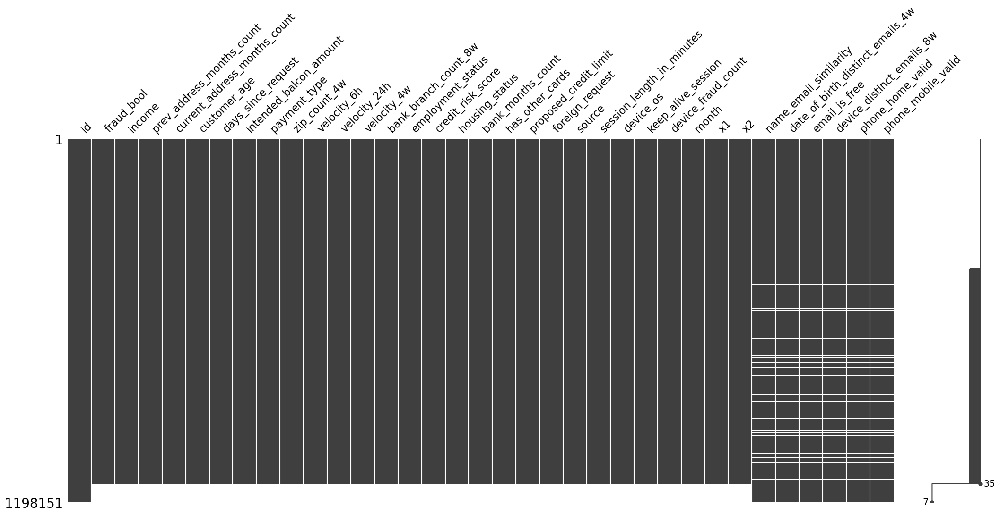

In [ ]:
import missingno as msgo
import matplotlib.pyplot as plt

msgo.matrix(df)

<AxesSubplot: >

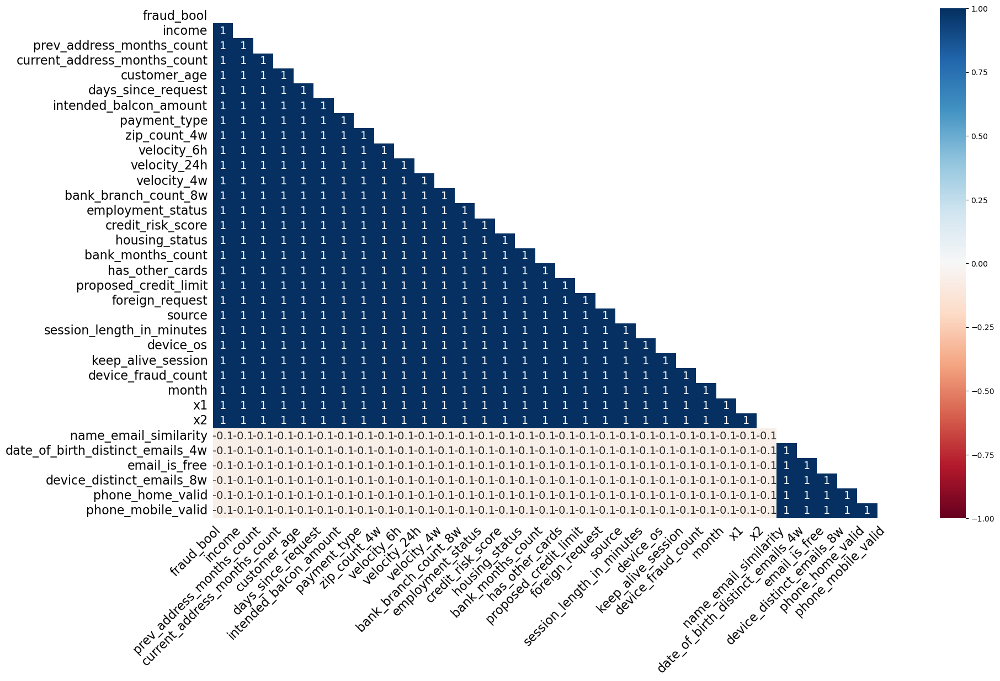

In [ ]:
msgo.heatmap(df)

En general estos resultado podrian ser más precisos, sin embargo, al unir el dataframe con la información correspondiente a correos y números telefónicos a través del método `outer`, se generaron muchos valores faltantes en columnas importantes para el estudio del fenómeno.

### 2.6 Limpiar

Según lo visto en las subsecciónes anteriores, es necesario eliminar los valores duplicados, puesto que no entregan información adicional del problema, así como también aquellos valores nulos presentes en las columnas de los dataframes `df1` y `df2`, dado que en particular estas filas que contienen a todos estos valores nulos no poseen el valor de `fraud_bool`, haciendo imposible su estudio.

Es posible eliminar también las filas con información faltante solo en las columnas del dataframe de elementos de contacto, sin embargo, estas filas aún contiene información útil para resolver el problema, por lo es posible realizar una imputación sobre estos datos suponiendo que no es posible verificar su información, es decir, reemplazando todos esos valores faltantes por 0 (ie, no es verificable o no tiene similitud según la información de dichas columnas). 

In [11]:
def SetAgeRange(age):
    if age < 18:
        return 'Joven'
    elif age >= 18 and age <= 26:
        return 'Adulto-Joven'
    elif age>= 27 and age <= 59:
        return 'Adulto'
    else:
        return 'Persona Mayor'

df = df.drop_duplicates(keep='first').dropna(subset=df1.columns).reset_index().drop(columns=['index']).sort_values('id').fillna(0)
df['segmentacion_etaria'] = df.customer_age.apply(SetAgeRange)

## 3. Análisis Exploratorio de Datos

In [17]:
#from ydata_profiling import ProfileReport

#profile = ProfileReport(df, title="EDA")
#profile.to_file("eda.html")

Se generó y se adjunta el html del eda para poder explorar la data interactivamente en el navegador con ProfileReport. Sin embargo, en las siguientes celdas se tienen un análisis particular de las variables y relaciones más relevantes encontradas.

### 3.1 Análisis del EDA

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt
colors = sns.color_palette('rocket_r')

Primero que todo, vamos a analizar nuestra variable objetivo, la cual es `fraud_bool`. Esta variable es binaria, por lo que podemos ver la cantidad de fraudes y no fraudes que tenemos en nuestro dataset.

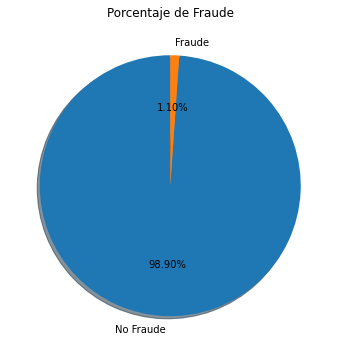

In [14]:
# se realiza un grafico de torta de la variabla fraud_bool, que es de alto interés
plt.figure(figsize=(6,6))
plt.pie(df.fraud_bool.value_counts(), labels=['No Fraude', 'Fraude'], autopct='%2.2f%%', shadow=True, startangle=90)
plt.title('Porcentaje de Fraude')
plt.show()


Se ve que la variable que indica fraude está fuertemente desbalanceada, teniendo solo un 1.1% de los datos como fraude, esto además nos sugiere que en un futuro debemos tener cuidado con los modelos que entrenemos, ya que estos pueden tener un sesgo hacia la clase mayoritaria, por lo que es necesario utilizar técnicas de balanceo de datos como oversampling o Undersampling.

- Ahora analizaremos las variables categóricas de payment_type, housing_status y employment_status.

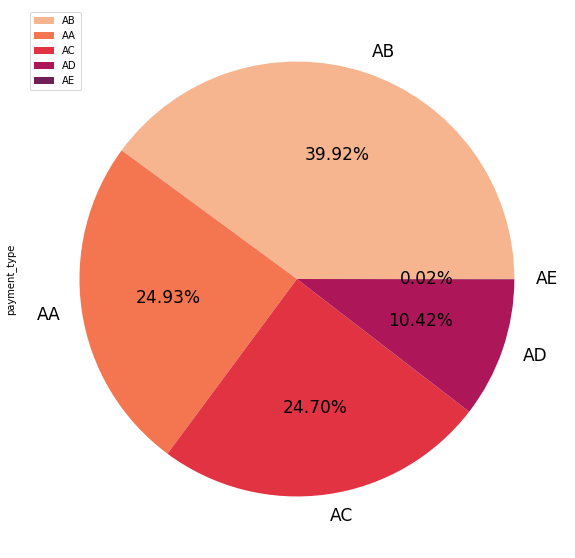

In [15]:
values = df['payment_type'].value_counts()
plt.figure(figsize=(10,10))
values.plot(kind='pie', colors = colors,fontsize=17, autopct='%.2f%%')
plt.legend(labels=values.index, loc="best")
plt.show()

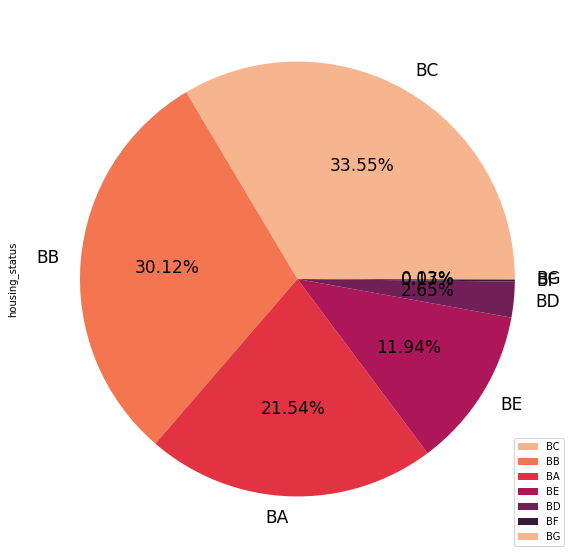

In [16]:
values = df['housing_status'].value_counts()
plt.figure(figsize=(10,10))
values.plot(kind='pie', colors = colors,fontsize=17, autopct='%.2f%%')
plt.legend(labels=values.index, loc="best")
plt.show()

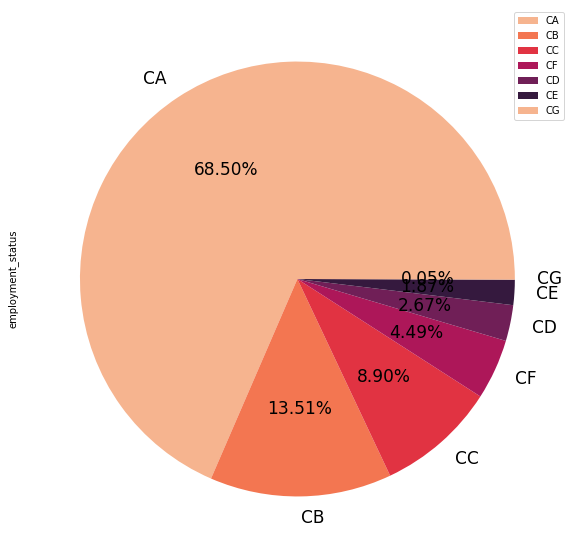

In [17]:
values = df['employment_status'].value_counts()
plt.figure(figsize=(10,10))
values.plot(kind='pie', colors = colors,fontsize=17, autopct='%.2f%%')
plt.legend(labels=values.index, loc="best")
plt.show()

Primero, es dificilhacer alguna interpretación sobre estas variables, ya que no sabemos que significa cada clase, lo que si podemos hacer es relacionarlas con la variable de fraude, para ver si en conjunto podemos hacer un análisis interesante.

A continuación, se procede a realizar un análisis multivariado de la relación entre estas variables y la variable a predecir, graficando la proporción de fraude para cada clase de las diferentes variables.

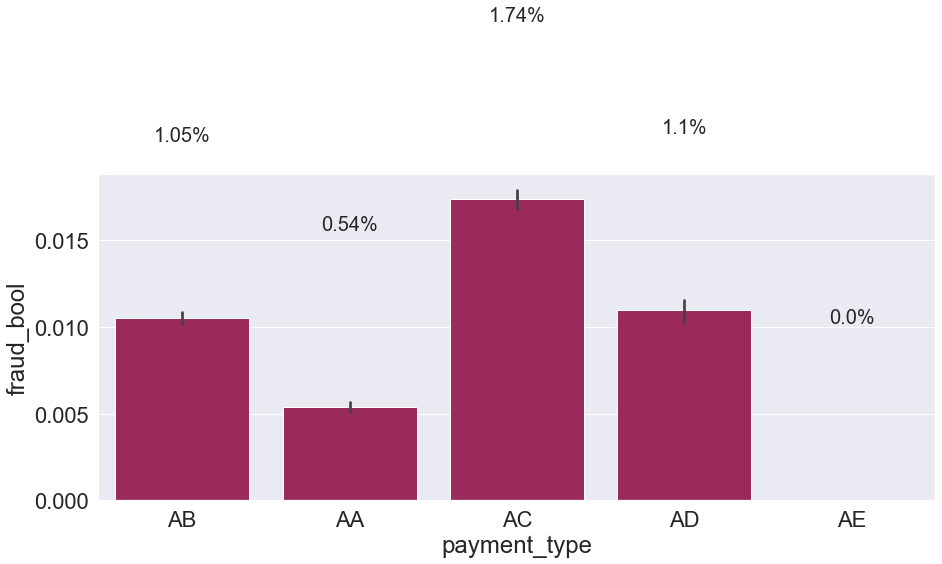

In [18]:
plt.figure(figsize=(15,6))
sns.set(font_scale=2)
sns.barplot(df['payment_type'], df['fraud_bool'],color='#AD1759')
# se agrega el porcentaje de fraude en cada barra
for i in range(len(df['payment_type'].unique())):
    count = df[df['payment_type']==df['payment_type'].unique()[i]]['fraud_bool'].mean()
    plt.text(i,count+0.01, str(np.round(count*100,2))+'%', ha='center', va='bottom', fontsize=20)
plt.show()

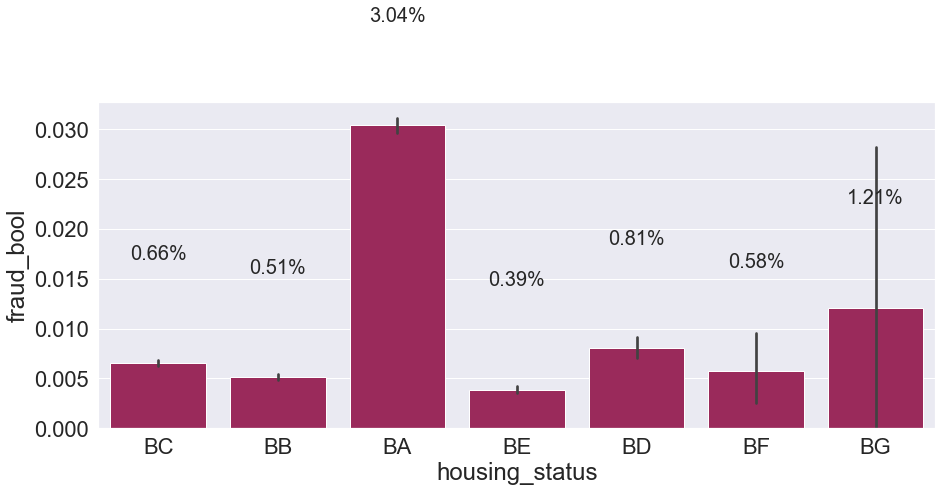

In [19]:
plt.figure(figsize=(15,6))
sns.set(font_scale=2)
sns.barplot(df['housing_status'], df['fraud_bool'],color='#AD1759')
# se agrega el porcentaje de fraude en cada barra
for i in range(len(df['housing_status'].unique())):
    count = df[df['housing_status']==df['housing_status'].unique()[i]]['fraud_bool'].mean()
    plt.text(i,count+0.01, str(np.round(count*100,2))+'%', ha='center', va='bottom', fontsize=20)
plt.show()

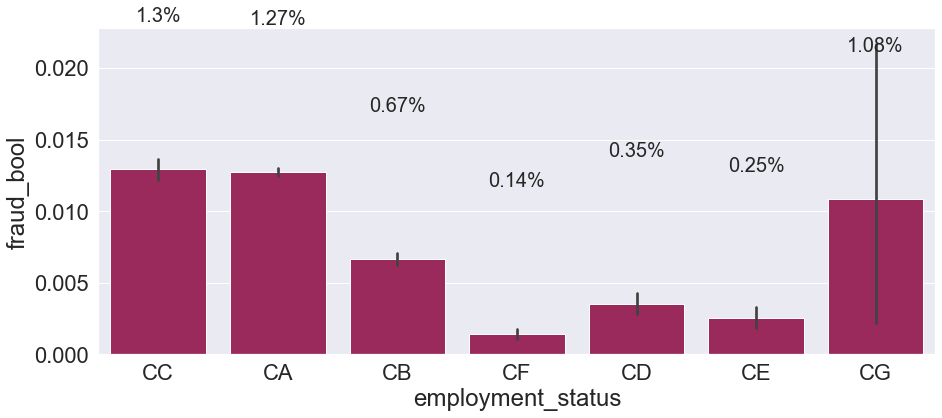

employment_status
CA    0.012736
CB    0.006665
CC    0.012952
CD    0.003525
CE    0.002511
CF    0.001430
CG    0.010846
Name: fraud_bool, dtype: float64


In [20]:
plt.figure(figsize=(15,6))
sns.set(font_scale=2)
sns.barplot(df['employment_status'], df['fraud_bool'],color='#AD1759')
# se agrega el porcentaje de fraude en cada barra
for i in range(len(df['employment_status'].unique())):
    count = df[df['employment_status']==df['employment_status'].unique()[i]]['fraud_bool'].mean()
    plt.text(i,count+0.01, str(np.round(count*100,2))+'%', ha='center', va='bottom', fontsize=20)
plt.show()


print(df.groupby('employment_status')['fraud_bool'].mean())

Si cada grupo de la categoría no tuviera relación con la variable a predecir, entonces la proporción de fraude debería ser la misma para cada grupo y cerca al promedio de un 1.1%, sin embargo, se ve que esto no es así, por lo que es posible que estas variables sean útiles para predecir el fraude.

En particular, podemos ver que la variable de housing_status tiene gran variación entre sus clases, siendo la de mayor proporción de fraude BA, con un 3%, mientras que las demás debajo de un 1.5%. 

Para cerrar este análisis se crea una tabla que agrupa housing status y payment_type con la segmentación etaria, se deja una tabla a continuación.

In [22]:
df.groupby(['segmentacion_etaria','housing_status', 'payment_type'])['fraud_bool'].agg(['mean', 'count']).sort_values('mean', ascending=False)


mean  count
segmentacion_etaria housing_status payment_type                 
Adulto              BG             AC            0.090909     22
Adulto-Joven        BF             AC            0.075472     53
Persona Mayor       BA             AC            0.057960   7626
Adulto-Joven        BA             AC            0.051465   2526
Persona Mayor       BF             AD            0.050000     20
...                                                   ...    ...
Joven               BD             AD            0.000000     22
                    BE             AE            0.000000      2
                    BF             AA            0.000000      5
                                   AB            0.000000      1
Persona Mayor       BG             AD            0.000000      1

[127 rows x 2 columns]

De esta última tabla podemos ver que efectivamente puede existir una relación entre estas variables y el fraude, ya que el primer grupo, de Adulto, Housing_status = BG y Payment_type = AC tienen un promedio de fraude de un 9%, un aumento bastante significativo con respecto al análisis individual de las variables, lo que indica que el modelo probablemente pueda aprender de estas variables para predecir el fraude.

Otra relación que podríamos ver es entre el fraude y la edad de los clientes, para esto se grafica la relación entre ambas.

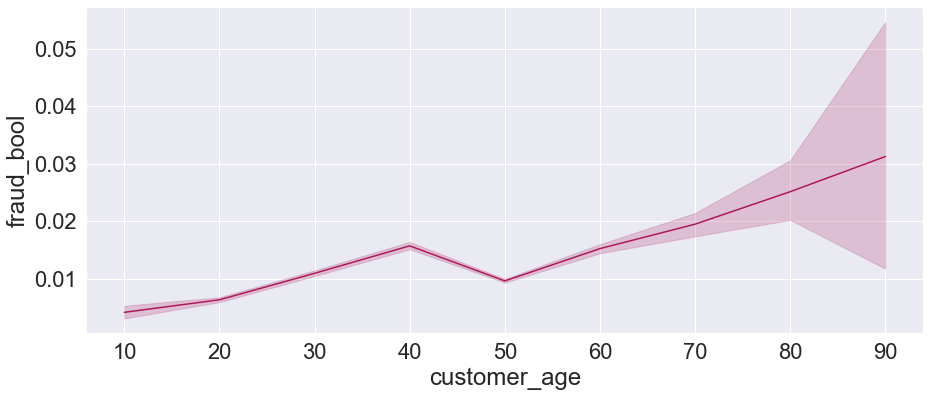

In [21]:
# graficamos la tendencia de la variable fraud_bool por mes
plt.figure(figsize=(15,6))
sns.set(font_scale=2)
sns.lineplot(df['customer_age'],df['fraud_bool'],color='#AD1759')
plt.show()

Efectivamente se puede apreciar que a mayor edad existe una mayor proporción de fraude, lo que podría indicar que los clientes más viejos son más propensos a cometer fraude. Sin embargo, es necesario tener cuidado con esta interpretación, ya que la cantidad de clientes más viejos es mucho menor que la de clientes más jóvenes, por lo que es posible que esta relación se deba a que hay menos datos de clientes viejos.



## 4. Preprocesamiento

A continuación se realizará un preprocesamiento de los datos, esto es debido a que las variables son de distinto tipo (categóricas, numéricas, ordinales), y no todas las variables numéricas tienen la misma escala, es por esto que se debe generar variables dummy para el caso de las variables categóricas, se debe definir una escala estándar para las variables numéricas y se le debe asignar el orden a las variables ordinales con el fin de evitar errores en el proceso de entrenamiento de modelos. Todo esto se puede hacer a través de la implementación de una pipeline que realice las transformaciones sobre el dataframe de forma directa y sencilla.

### 4.1 Declarar `ColumnTransformer`

In [18]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler, MinMaxScaler, PowerTransformer

# Obtener las columnas numéricas sin las binarias
columnas_numericas = df.select_dtypes(include=['int', 'float']).columns
columnas_numericas = columnas_numericas.difference(df.columns[df.nunique() == 2])
print("Columnas numéricas:")
print(columnas_numericas)

# Obtener las columnas binarias sin las categóricas
columnas_binarias = df.columns[df.nunique() == 2]
columnas_binarias = columnas_binarias.difference(df.select_dtypes(include=['object']).columns).drop('fraud_bool')
print("\nColumnas binarias:")
print(columnas_binarias)

# Obtener las columnas categóricas
columnas_categoricas = df.select_dtypes(include=['object']).columns.drop('segmentacion_etaria')
print("\nColumnas categóricas:")
print(columnas_categoricas)
ordinal_cat = [['Joven', 'Adulto-Joven','Adulto','Persona Mayor']]

# Pipeline Numerica
num_pipe = Pipeline(
    steps=[
        ("scaler", MinMaxScaler())
    ]
)

# Pipeline categorica
cat_pipe = Pipeline(
    steps=[
        ("onehot", OneHotEncoder(sparse=False, handle_unknown="ignore"))
    ]
)

# Pipeline Ordinal
ord_pipe = Pipeline(
    steps=[
        ("ordinal", OrdinalEncoder(categories=ordinal_cat))
    ]
)

# Preprocesador Compuesto
prep = ColumnTransformer(
    transformers=[
        ('pass', 'passthrough',['id','fraud_bool']),
        ("num", num_pipe, columnas_numericas),
        ("cat", cat_pipe, columnas_categoricas),
        ("ord", ord_pipe, ['segmentacion_etaria']),
    ]
)

prep

Columnas numéricas:
Index(['bank_branch_count_8w', 'bank_months_count', 'credit_risk_score',
       'current_address_months_count', 'customer_age',
       'date_of_birth_distinct_emails_4w', 'days_since_request',
       'device_distinct_emails_8w', 'device_fraud_count', 'id', 'income',
       'intended_balcon_amount', 'month', 'name_email_similarity',
       'prev_address_months_count', 'proposed_credit_limit',
       'session_length_in_minutes', 'velocity_24h', 'velocity_4w',
       'velocity_6h', 'x1', 'x2', 'zip_count_4w'],
      dtype='object')

Columnas binarias:
Index(['email_is_free', 'foreign_request', 'has_other_cards',
       'keep_alive_session', 'phone_home_valid', 'phone_mobile_valid'],
      dtype='object')

Columnas categóricas:
Index(['payment_type', 'employment_status', 'housing_status', 'source',
       'device_os'],
      dtype='object')


ColumnTransformer(transformers=[('pass', 'passthrough', ['id', 'fraud_bool']),
                                ('num',
                                 Pipeline(steps=[('scaler', MinMaxScaler())]),
                                 Index(['bank_branch_count_8w', 'bank_months_count', 'credit_risk_score',
       'current_address_months_count', 'customer_age',
       'date_of_birth_distinct_emails_4w', 'days_since_request',
       'device_distinct_emails_8w', 'device_fraud_count', 'id...
       'velocity_6h', 'x1', 'x2', 'zip_count_4w'],
      dtype='object')),
                                ('cat',
                                 Pipeline(steps=[('onehot',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False))]),
                                 Index(['payment_type', 'employment_status', 'housing_status', 'source',
       'device_os'],
      dtype='object')),
                                ('ord',
                                 Pipeline(steps=[('ordinal',
                                                  OrdinalEncoder(categories=[['Joven',
                                                                              'Adulto-Joven',
                                                                              'Adulto',
                                                                              'Persona '
                                                                              'Mayor']]))]),
                                 ['segmentacion_etaria'])])

### 4.2 Transformar datos

In [19]:
df_transformed = pd.DataFrame(prep.fit_transform(df))
df_transformed.columns = prep.get_feature_names_out()
df_transformed

,pass__id,pass__fraud_bool,num__bank_branch_count_8w,num__bank_months_count,num__credit_risk_score,num__current_address_months_count,num__customer_age,num__date_of_birth_distinct_emails_4w,num__days_since_request,num__device_distinct_emails_8w,...,cat__housing_status_BF,cat__housing_status_BG,cat__source_INTERNET,cat__source_TELEAPP,cat__device_os_linux,cat__device_os_macintosh,cat__device_os_other,cat__device_os_windows,cat__device_os_x11,ord__segmentacion_etaria
0,0.0,0.0,0.320993,0.939394,0.642478,0.048837,0.625,0.051282,0.000290,1.000000,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0
1,2.0,0.0,0.000421,0.969697,0.688496,0.097674,0.500,0.179487,0.000034,0.666667,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0
2,3.0,0.0,0.000421,0.212121,0.543363,0.023256,0.500,0.025641,0.000053,0.666667,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0
3,4.0,0.0,0.005048,0.363636,0.603540,0.072093,0.250,0.205128,0.000153,0.666667,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0
4,5.0,0.0,0.000421,0.000000,0.676106,0.016279,0.500,0.128205,0.000315,0.666667,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
934853,999995.0,1.0,0.000000,0.000000,0.389381,0.269767,0.500,0.025641,0.000218,0.666667,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0
934854,999996.0,0.0,0.000841,0.909091,0.624779,0.020930,0.125,0.307692,0.000118,0.666667,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
934855,999997.0,0.0,0.000000,0.939394,0.860177,0.711628,0.500,0.076923,0.000016,0.666667,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0
934856,999998.0,0.0,0.006731,0.060606,0.642478,0.086047,0.625,0.205128,0.000415,0.666667,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0


## 5. Visualización en Baja Dimensionalidad

En esta sección se intentará encontrar algún tipo de patrón que se pueda apreciar de forma visual dentro de las transacciones marcadas como fraudulentas, no obstante, existen muchas variables numéricas para elegir como indicadores en caso de tener que seleccionar dos y es imposible graficar con más de 3 dimensiones, por lo que una buena opción es utilizar un método de reducción dimensional para compactar la información contenida de todas las variables en otras que si se puedan graficar.

Para esto se utilizarán y compararán 2 métodos: `PCA` (Principal Components Analysis), el cual realiza combinaciones lineales de variables para generar hiperplanos (componentes principales) cuya característica es que el promedio de las de las distancias al cuadrado de las proyecciones de los puntos sobre ellos (los hiperplanos) es máximo, es decir, explica la mayor cantidad de varianza y no están correlacionados entre si; y `UMAP` (Uniform Manifolds Aproximations and Projections for Dimension Reduction) el cual utiliza un concepto de topología algebráica llamado homotopía para relacionar la "forma de la nube de puntos" (similar a un grafo) en altas dimensiones con la forma de la nube de puntos de sus proyecciones en bajas dimensiones.

En ambos casos se realizarán proyecciones sobre 2 dimensiones para poder graficar los puntos y verificar si es que existe un patron apreciable que pueda servir para identificar los fraudes.

Además, teniendo en cuenta que distintos grupos etarios tienen distintos comportamientos financieros, se generará un análisis para cada uno de estos grupos por separado.

### 5.1 Muestrear dataframe

Se realiza un sampleo de los datos debido a las limitaciones de recursos computacionales.

In [20]:
sample = df_transformed.sample(25000, random_state=123)

### 5.2 Proyectar y agregar proyecciones al dataframe de muestreo

Aquí es necesario mencionar que el objetivo de proyectar los datos es encontrar variables que sean informativas para dar con nuestro objetivo, el cual es la columna `fraud_bool`, por lo que esta no debe ser incluida dentro de las proyecciones porque estaría agregando información futura a los modelos. 

In [21]:
import umap.umap_ as umap
from sklearn.decomposition import PCA

sample_ids = sample.pass__id
sample_target = sample.pass__fraud_bool
sample = sample.drop(columns = ['pass__id', 'pass__fraud_bool'])

#pca
pca = PCA(n_components=2)
values = pca.fit_transform(sample)

#umap
umap = umap.UMAP()
umap_feats = umap.fit_transform(sample)

#se agregan las proyecciones al dataframe sample
sample['x_umap'] = umap_feats[:, 0]
sample['y_umap'] = umap_feats[:, 1]
sample['x_pca'] = values[:, 0]
sample['y_pca'] = values[:, 1]

### 5.3 Visualizar según rangos etarios

In [22]:
joven = sample[sample.ord__segmentacion_etaria == 0]
ajoven = sample[sample.ord__segmentacion_etaria == 1]
adulto = sample[sample.ord__segmentacion_etaria == 2]
pmayor = sample[sample.ord__segmentacion_etaria == 3]

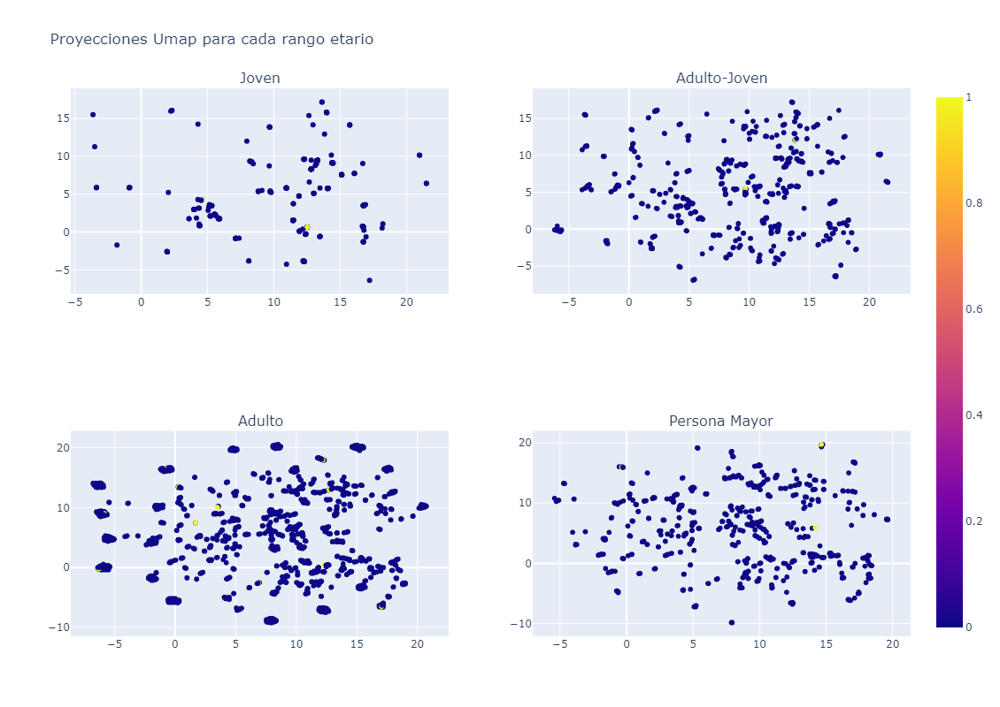

In [23]:
import plotly.express as px
from plotly.subplots import make_subplots

fig_joven = px.scatter(joven, x = 'x_umap', y = 'y_umap',
                       color = df.loc[joven.index].fraud_bool,
                       #symbol=df.loc[joven.index].fraud_bool,
                       size_max=0.1)

fig_ajoven = px.scatter(ajoven, x = 'x_umap', y = 'y_umap',
                        color = df.loc[ajoven.index].fraud_bool,
                        #symbol=df.loc[ajoven.index].fraud_bool,
                        size_max=0.1)

fig_adulto = px.scatter(adulto, x = 'x_umap', y = 'y_umap',
                        color = df.loc[adulto.index].fraud_bool,
                        #symbol = df.loc[adulto.index].fraud_bool,
                        size_max=0.1)

fig_pmayor = px.scatter(pmayor, x = 'x_umap', y = 'y_umap',
                        color = df.loc[pmayor.index].fraud_bool,
                        #symbol = df.loc[pmayor.index].fraud_bool,
                        size_max=0.1)

fig = (make_subplots(rows=2, cols=2, subplot_titles=("Joven", "Adulto-Joven", "Adulto", "Persona Mayor"))
       .add_trace(fig_joven.data[0], row=1, col=1)
       .add_trace(fig_ajoven.data[0], row=1, col=2)
       .add_trace(fig_adulto.data[0], row=2, col=1)
       .add_trace(fig_pmayor.data[0], row=2, col=2)
       .update_layout(height=800, width = 800, title_text="Proyecciones Umap para cada rango etario")
       .show()
)

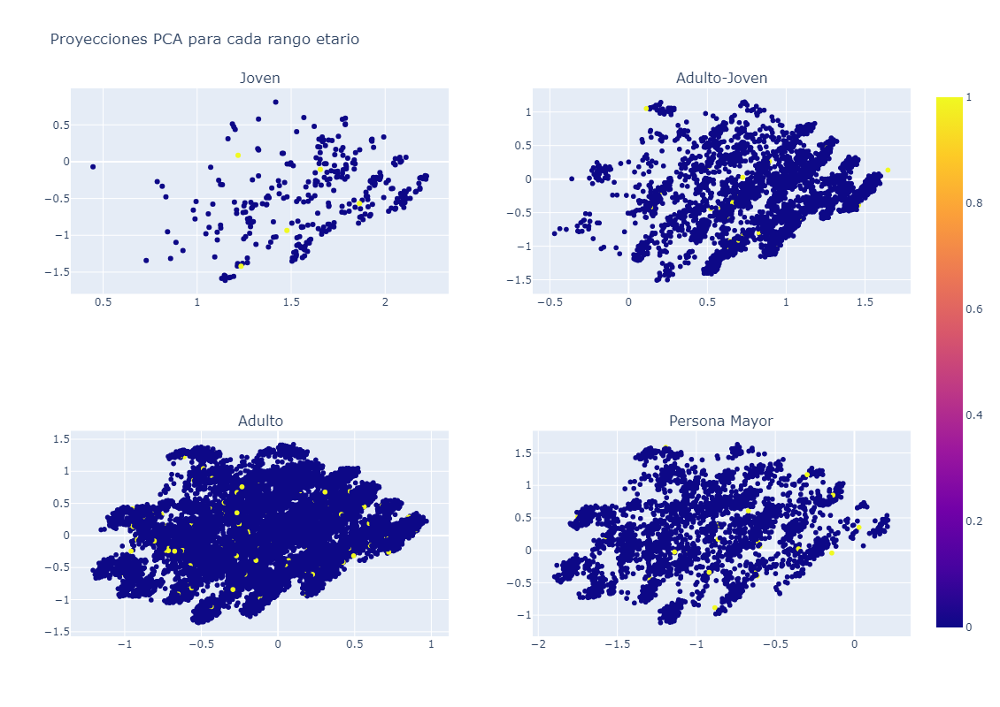

In [24]:
fig_joven_pca = px.scatter(joven, x = 'x_pca', y = 'y_pca',
                       color = df.loc[joven.index].fraud_bool,
                       #symbol=df.loc[joven.index].fraud_bool,
                       size_max=0.1)

fig_ajoven_pca = px.scatter(ajoven, x = 'x_pca', y = 'y_pca',
                        color = df.loc[ajoven.index].fraud_bool,
                        #symbol=df.loc[ajoven.index].fraud_bool,
                        size_max=0.1)

fig_adulto_pca = px.scatter(adulto, x = 'x_pca', y = 'y_pca',
                        color = df.loc[adulto.index].fraud_bool,
                        #symbol = df.loc[adulto.index].fraud_bool,
                        size_max=0.1)

fig_pmayor_pca = px.scatter(pmayor, x = 'x_pca', y = 'y_pca',
                        color = df.loc[pmayor.index].fraud_bool,
                        #symbol = df.loc[pmayor.index].fraud_bool,
                        size_max=0.1)

fig_pca = (make_subplots(rows=2, cols=2, subplot_titles=("Joven", "Adulto-Joven", "Adulto", "Persona Mayor"))
       .add_trace(fig_joven_pca.data[0], row=1, col=1)
       .add_trace(fig_ajoven_pca.data[0], row=1, col=2)
       .add_trace(fig_adulto_pca.data[0], row=2, col=1)
       .add_trace(fig_pmayor_pca.data[0], row=2, col=2)
       .update_layout(height=800, width = 800, title_text="Proyecciones PCA para cada rango etario")
       .show()
)

## 6. Anomalías

Finalmente, se genera un modelo para indentificar fraudes. En este caso notamos que el problema se puede tratar como uno de clasificación binaria, en el que según una serie de features se busca predecir el valor de un booleano. Para esto se puede usar un clasificador lineal del tipo SVM ya que este tipo de clasificadores funciona bien en el caso binario, además son robustos a outliers y trabajan relativamente bien en altas dimensiones (al aplicar kernels).

A continuación se muestra la implementacion del clasificador `SGDClassifier` el cual puede realizar distintos tipos de clasificación lineal utilizando descenso de gradiente estocástico para entrenarse, lo cual permite entrenar con más datos.

### 6.1 Implementar detector de anomalías sobre dataframe de muestreo

In [25]:
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler


def DetectorAnomalias(df, imb_sampler = 'under' , get_cm = False, rs = None):
    df = df.copy()
    df_id = df.pass__id
    df_tar = df.pass__fraud_bool
    df = df.drop(columns=['pass__id','pass__fraud_bool'])
    
    
    if imb_sampler == 'under':
        X_train, X_test, y_train, y_test = train_test_split(df,
                                                            df_tar,
                                                            stratify = df_tar,
                                                            test_size=0.15,
                                                            random_state=rs)
        
        rus = RandomUnderSampler(random_state = rs)
        
        X_train_under, y_train_under = rus.fit_resample(X_train, y_train)
        
        SGD_under = SGDClassifier(loss="hinge", alpha=0.01, max_iter=200)
        SGD_under.fit(X_train_under, y_train_under)
        
        
        print('SGDClassifier Score: ',SGD_under.score(X_test, y_test))
        cm_under = confusion_matrix(y_test, SGD_under.predict(X_test))
        disp_under = ConfusionMatrixDisplay(confusion_matrix=cm_under, display_labels=SGD_under.classes_)
        disp_under.plot()
        plt.show()
        
        if get_cm:
            return SGD_under, cm_under
        return SGD_under
    
    elif imb_sampler == 'over':
        
        
        
        X_train, X_test, y_train, y_test = train_test_split(df,
                                                            df_tar,
                                                            stratify=df_tar,
                                                            test_size=0.15,
                                                            random_state=rs)
        
        ros = RandomOverSampler(random_state = rs)
        
        X_train_over, y_train_over = ros.fit_resample(X_train, y_train)
    
        SGD_over = SGDClassifier(loss='hinge', alpha=0.01, max_iter=200)
        SGD_over.fit(X_train_over, y_train_over)
        
        print('SGDClassifier Score: ',SGD_over.score(X_test, y_test))
        cm_over = confusion_matrix(y_test,SGD_over.predict(X_test))
        disp_over = ConfusionMatrixDisplay(confusion_matrix=cm_over, display_labels=SGD_over.classes_)
        disp_over.plot()
        plt.show()
        
        if get_cm:
            return SGD_over, cm_over
        
        return SGD_over 

joven_full = df_transformed[df_transformed.ord__segmentacion_etaria == 0].drop(columns=['ord__segmentacion_etaria'])
ajoven_full = df_transformed[df_transformed.ord__segmentacion_etaria == 1].drop(columns=['ord__segmentacion_etaria'])
adulto_full = df_transformed[df_transformed.ord__segmentacion_etaria == 2].drop(columns=['ord__segmentacion_etaria'])
pmayor_full = df_transformed[df_transformed.ord__segmentacion_etaria == 3].drop(columns=['ord__segmentacion_etaria'])

#### Rango etario: Joven

Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.9406919275123559


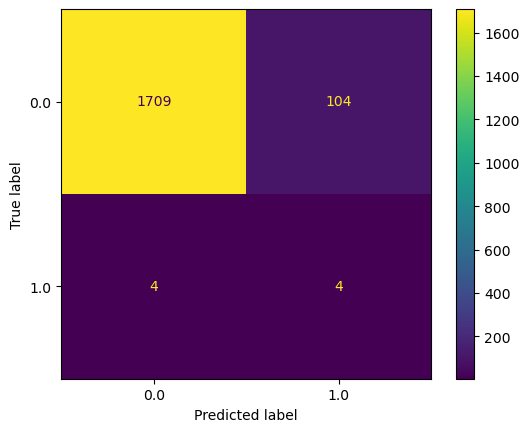

Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.9319055464030752


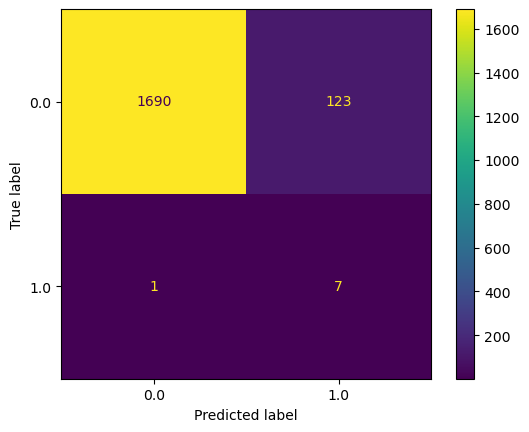

In [26]:
print('Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_under_joven, cm_under_joven = DetectorAnomalias(joven_full, imb_sampler = 'under', get_cm = True, rs = 123)
print('Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_over_joven, cm_over_joven = DetectorAnomalias(joven_full, imb_sampler = 'over', get_cm = True, rs = 123)

#### Rango etario: Adulto-Joven

Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.93462434478742


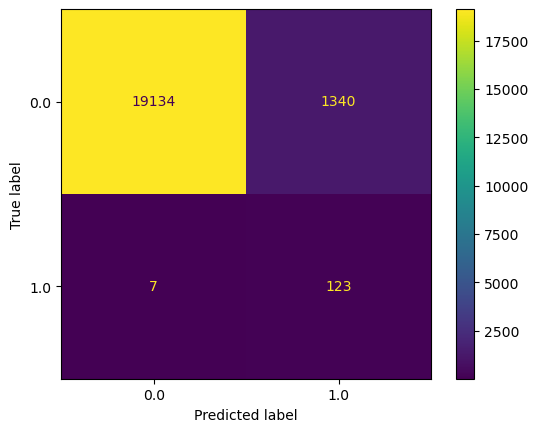

Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.946078431372549


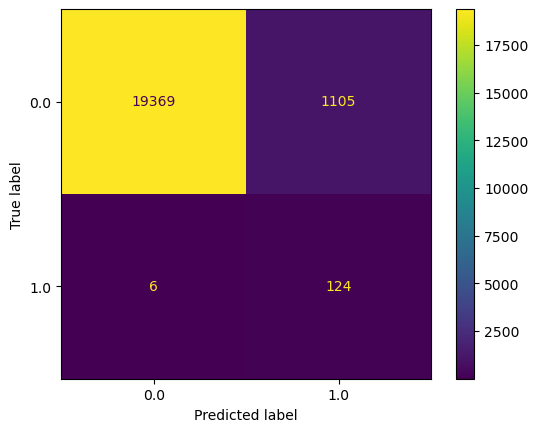

In [27]:
print('Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_under_ajoven, cm_under_ajoven = DetectorAnomalias(ajoven_full, imb_sampler = 'under', get_cm = True, rs = 123)
print('Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_over_ajoven, cm_over_ajoven = DetectorAnomalias(ajoven_full, imb_sampler = 'over', get_cm = True, rs = 123)

#### Rango etario: Adulto

Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir 

SGDClassifier Score:  0.8040494200204757


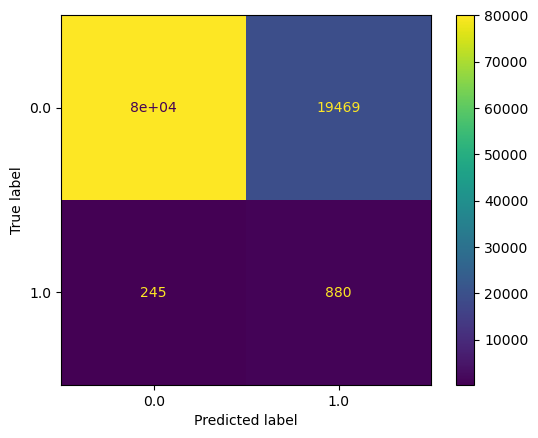

Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.8022602800997942


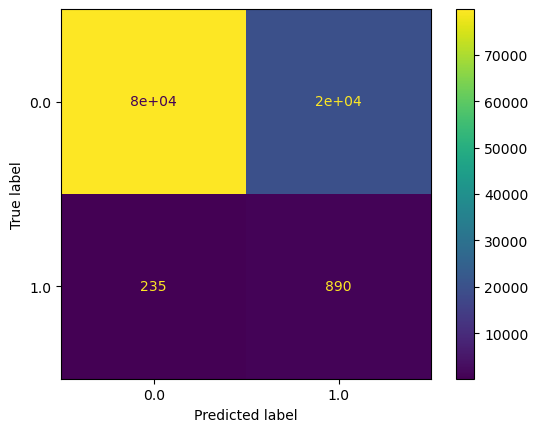

In [28]:
print('Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir \n')
SGD_under_adulto, cm_under_adulto = DetectorAnomalias(adulto_full, imb_sampler = 'under', get_cm = True, rs = 123)
print('Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_over_adulto, cm_over_adulto = DetectorAnomalias(adulto_full, imb_sampler = 'over', get_cm = True, rs = 123)

Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.7310152343295732


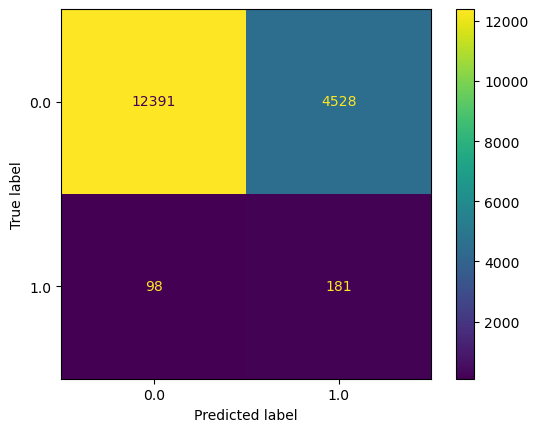

Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir

SGDClassifier Score:  0.7236888010233749


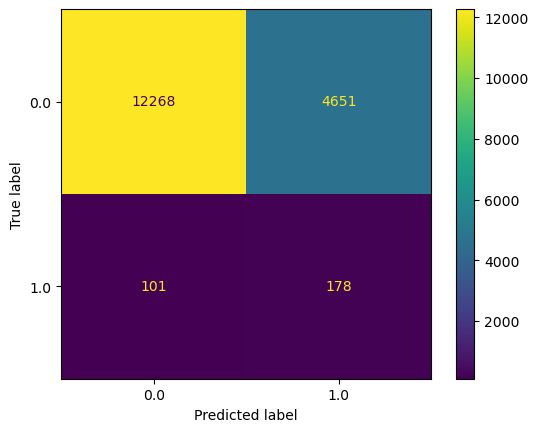

In [29]:
print('Estrategia de UnderSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_under_pmayor, cm_under_pmayor = DetectorAnomalias(pmayor_full, imb_sampler = 'under', get_cm = True, rs = 123)
print('Estrategia de OverSampling para lidiar con el debalanceo de la clase a predecir\n')
SGD_over_pmayor, cm_over_pmayor = DetectorAnomalias(pmayor_full, imb_sampler = 'over', get_cm = True, rs = 123)

### 6.2 Agregar resultados a dataframe de muestreo

In [30]:
jf = joven_full.drop(columns=['pass__id', 'pass__fraud_bool'])
joven_full['SGD_under'] = SGD_under_joven.predict(jf)
joven_full['SGD_over'] = SGD_over_joven.predict(jf)

ajf = ajoven_full.drop(columns=['pass__id', 'pass__fraud_bool'])
ajoven_full['SGD_under'] = SGD_under_ajoven.predict(ajf)
ajoven_full['SGD_over'] = SGD_over_ajoven.predict(ajf)

af = adulto_full.drop(columns=['pass__id', 'pass__fraud_bool'])
adulto_full['SGD_under'] = SGD_under_adulto.predict(af)
adulto_full['SGD_over'] = SGD_over_adulto.predict(af)

pmf = pmayor_full.drop(columns=['pass__id', 'pass__fraud_bool'])
pmayor_full['SGD_under'] = SGD_under_pmayor.predict(pmf)
pmayor_full['SGD_over'] = SGD_under_pmayor.predict(pmf)

### 6.3 Visualizar según rangos etarios

In [31]:
import umap.umap_ as umap
def SamplerPloter(df, re, imbl_sampler = 'under', rs = None):
    sample = df.sample(10000, random_state = rs)
    sample_ids = sample.pass__id
    sample_target = sample.pass__fraud_bool
    sample = sample.drop(columns = ['pass__id', 'pass__fraud_bool', 'SGD_under', 'SGD_over'])

    #pca
    pca = PCA(n_components=2)
    values = pca.fit_transform(sample)

    #umap
    uma = umap.UMAP()
    umap_feats = uma.fit_transform(sample)

    #se agregan las proyecciones al dataframe sample
    sample['x_umap'] = umap_feats[:, 0]
    sample['y_umap'] = umap_feats[:, 1]
    sample['x_pca'] = values[:, 0]
    sample['y_pca'] = values[:, 1]
    

    fig_joven_under_umap = px.scatter(sample, x = 'x_umap', y = 'y_umap',
                           color = df.loc[sample.index].SGD_under,
                           #symbol=df.loc[joven.index].fraud_bool,
                           size_max=0.1)
    fig_joven_over_umap = px.scatter(sample, x = 'x_umap', y = 'y_umap',
                           color = df.loc[sample.index].SGD_over,
                           #symbol=df.loc[joven.index].fraud_bool,
                           size_max=0.1)
    fig_joven_under_pca = px.scatter(sample, x = 'x_pca', y = 'y_pca',
                           color = df.loc[sample.index].SGD_under,
                           #symbol=df.loc[joven.index].fraud_bool,
                           size_max=0.1)
    fig_joven_over_pca = px.scatter(sample, x = 'x_pca', y = 'y_pca',
                           color = df.loc[sample.index].SGD_over,
                           #symbol=df.loc[joven.index].fraud_bool,
                           size_max=0.1)
    
    fig = (make_subplots(rows=2, cols=2, subplot_titles=("SGD_under UMAP", "SGD_over UMAP","SGD_under PCA", "SGD_over PCA"))
           .add_trace(fig_joven_under_umap.data[0], row=1, col=1)
           .add_trace(fig_joven_over_umap.data[0], row=1, col=2)
           .add_trace(fig_joven_under_pca.data[0], row=2, col=1)
           .add_trace(fig_joven_over_pca.data[0], row=2, col=2)
           .update_layout(height=800, width = 800, title_text="Proyecciones UMAP y PCA rango etario: {}".format(re))
           .show()
)

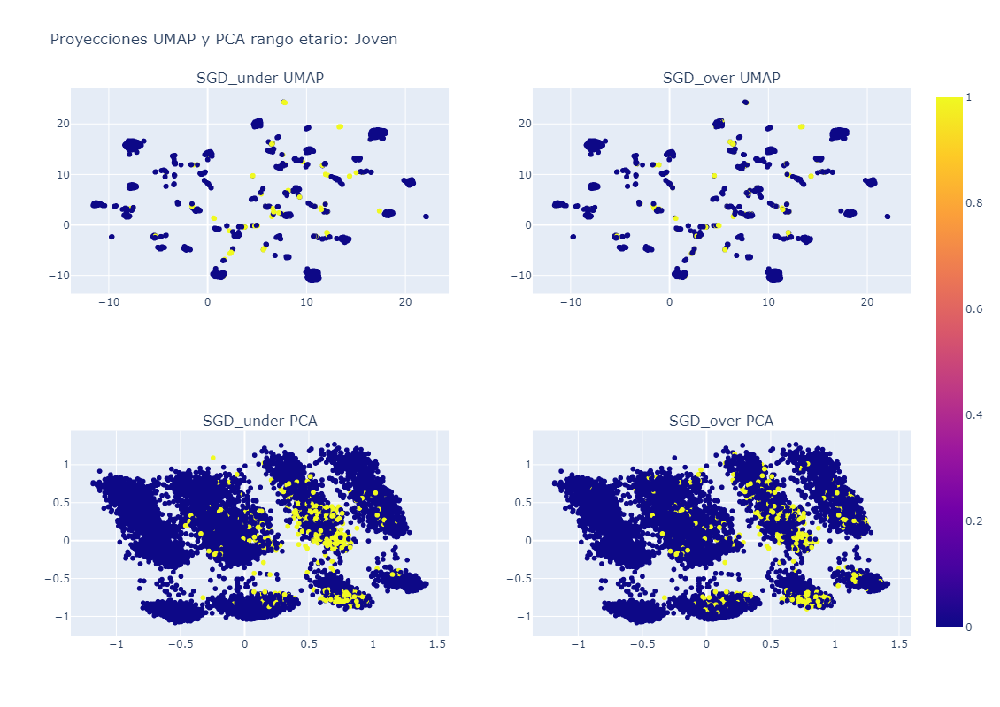

In [32]:
SamplerPloter(joven_full,'Joven', rs = 123)

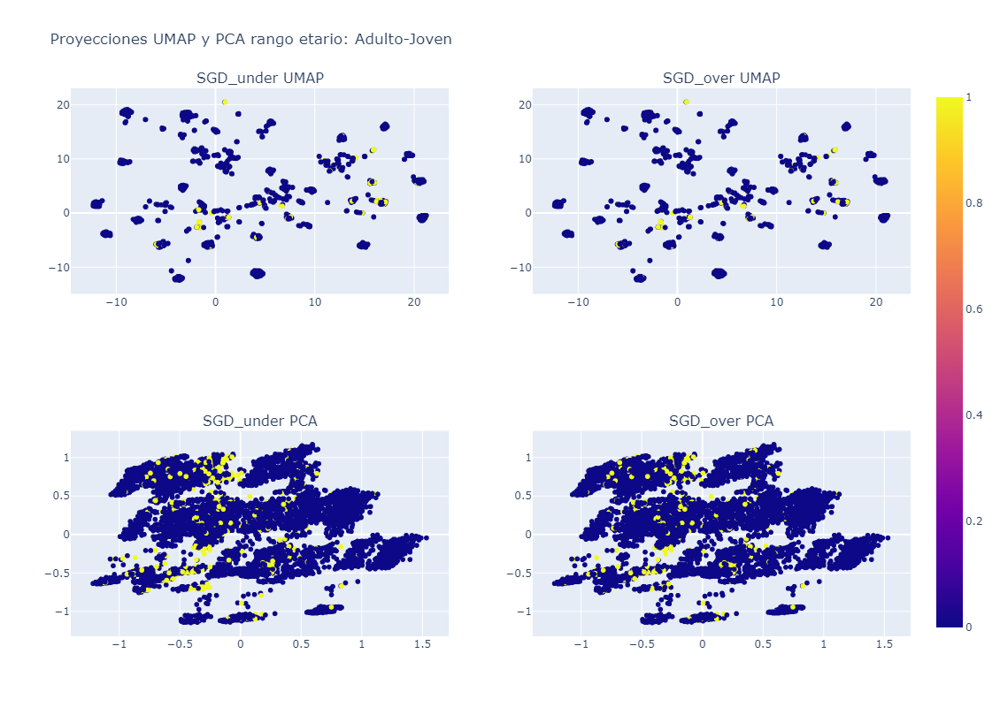

In [33]:
SamplerPloter(ajoven_full,'Adulto-Joven', rs = 123)

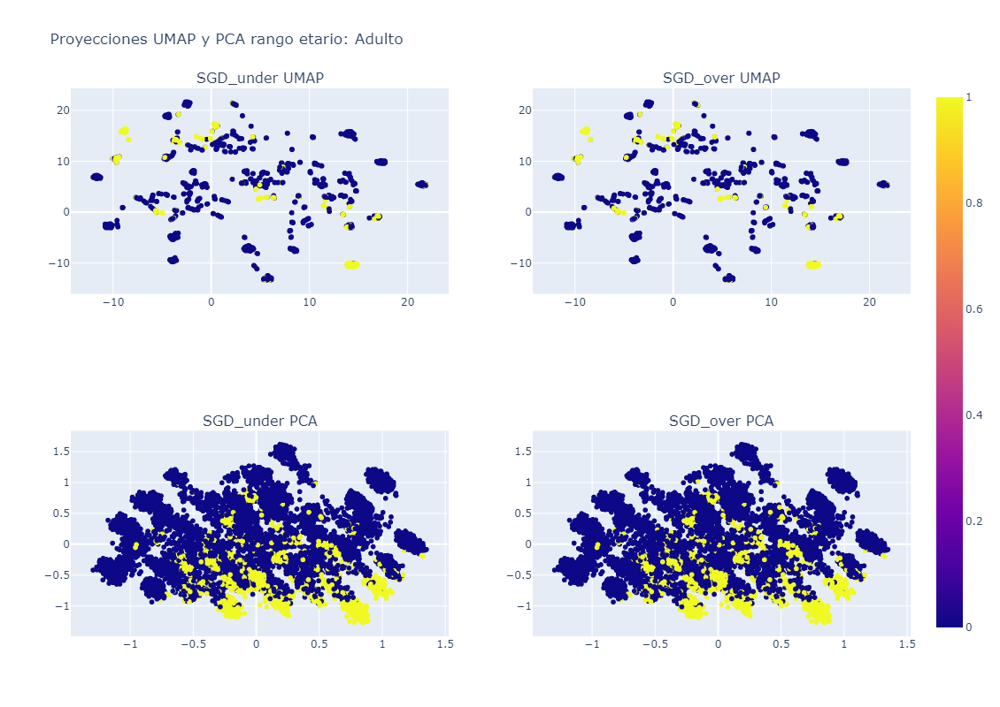

In [34]:
SamplerPloter(adulto_full,'Adulto', rs = 123)

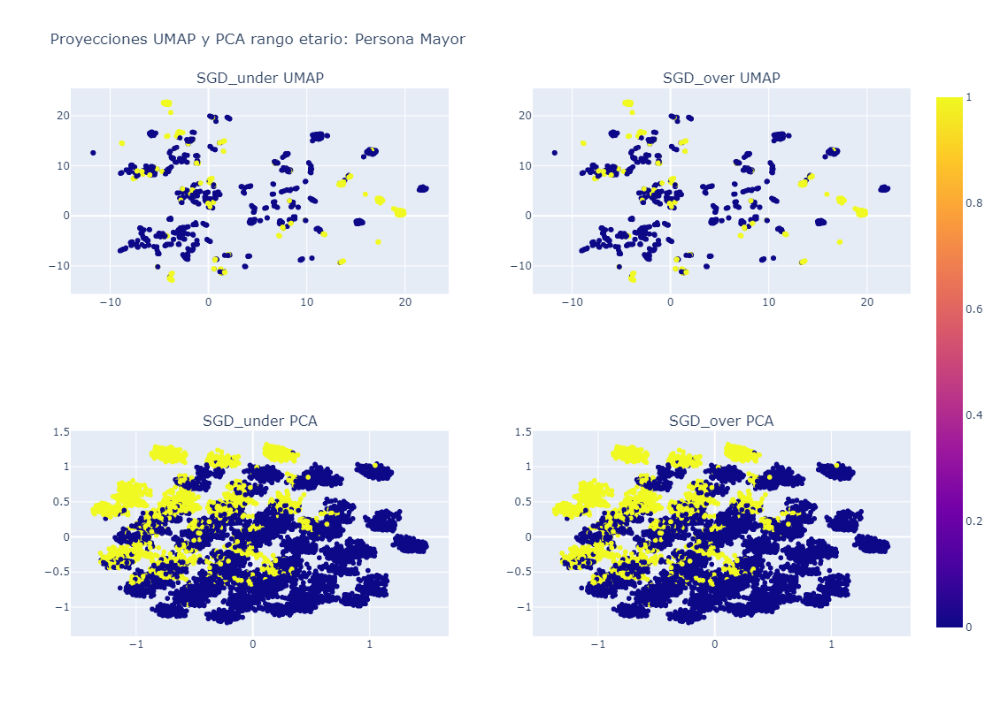

In [35]:
SamplerPloter(pmayor_full,'Persona Mayor', rs = 123)

### 6.4 Calcular ratios y responder

In [36]:
def Ratios(cm_under, cm_over):
    P_under = cm_under[1,1] / cm_under[:, 1].sum()
    P_over = cm_over[1,1] / cm_over[:, 1].sum()
    
    R_under = cm_under[1,1] / cm_under[ 1, :].sum()
    R_over = cm_over[1,1] / cm_over[1, :].sum()
    
    print('P under: {} , P over: {}\n'.format(P_under,P_over))
    print('R under: {} , R over: {}\n'.format(R_under,R_over))
    
    return None

In [37]:
Ratios(cm_under_joven, cm_over_joven)

P under: 0.037037037037037035 , P over: 0.05384615384615385

R under: 0.5 , R over: 0.875



In [38]:
Ratios(cm_under_ajoven, cm_over_ajoven)

P under: 0.08407382091592618 , P over: 0.10089503661513426

R under: 0.9461538461538461 , R over: 0.9538461538461539



In [39]:
Ratios(cm_under_adulto, cm_over_adulto)

P under: 0.0432453683227677 , P over: 0.04331111002968514

R under: 0.7822222222222223 , R over: 0.7911111111111111



In [40]:
Ratios(cm_under_pmayor, cm_over_pmayor)

P under: 0.0384370354640051 , P over: 0.03686063367156761

R under: 0.6487455197132617 , R over: 0.6379928315412187



Notemos que los ratios que se están calculando corresponden a la precisión, el cual se encarga de verificar la calidad del modelo, y al recall el cual se encarga de verificar la cantidad de aciertos que el modelo es capaz de realizar.

En nuestro caso se puede ver que la precisión del modelo es muy baja, lo que quiere decir que, al momento de predecir un valor como fraude, entre el 90% y el 97% de las veces la predicción será erronea, mientras que por otro lado, el recall en nuestro caso indica que el modelo es capaz de identificar correctamente entre un 70% y un 93% de las transacciones que son realmente fraude.

Esto es interesante pues si bien la precisión del modelo es muy mala, el hecho de que el recall sea relativamente bueno permitiría utilizar este modelo como un primer filtro para reducir la cantidad de casos que hay que estudiar con más detalle.

En general, los resultados tienen sentido pues si bien se realizó un adecuado preprocesamiento de los datos, el hecho de tener una clase objetivo muy desbalanceada es un factor limitante muy importante. Además, según los análisis exploratorios realizados no hay un patrón evidente en los datos, lo que se puede apreciar en la sección 5 al encontrar valores etiquetados como fraude que se confunden con otros valores que no lo son por lo que resulta especialmente dificil entrenar un modelo sencillo que sea más potente. En particular el modelo utilizado era uno de carácter lineal, dejando margen para mejoras.

Finalmente se puede notar que resulta útil la segmentacion etaria puesto que los distintos rangos tienen distintos comportamientos financieros. Haciendo una inspección sobre las transacciones catalogadas como fraude se puede ver la mayoría están concentradas cerca de ciertos rangos etarios, lo que puede significar que la edad es un factor importante a la hora de verificar la veracidad de una transacción. Esto deja las puertas abiertas para realizar un trabajo de feature importance para identificar con más precisión cuales son las variables que más influyen al momento de clasificar las transacciones.
